# PART A - Autoencoder
In this part we will construct and compare different autoencoder models for the image colourization task.

## Part 3 Skip Connections
A skip connection in a neural network is a connection which skips one or more layer and connects to a later layer. In this section I will be incorporating skip connections to improve on our model architecture.

### Part (i)
Add a skip connection from the first layer to the last, second layer to the second last, etc.
That is, the final convolution should have both the output of the previous layer and the initial greyscale input as input. This type of skip-connection architecture and is called a "UNet".

In [ ]:
from numpy.core.numeric import outer


class UNet(nn.Module):
    def __init__(self, kernel, num_filters, num_colours=3, num_in_channels=1):
        super().__init__()

        # Useful parameters
        stride = 2
        padding = kernel // 2
        output_padding = 1

        ###################################################
        self.downconv1 = nn.Sequential(
            nn.Conv2d(num_in_channels, num_filters, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters),
            nn.ReLU(),
            nn.MaxPool2d(2),)

        self.downconv2 = nn.Sequential(
            nn.Conv2d(num_filters, num_filters*2, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters*2),
            nn.ReLU(),
            nn.MaxPool2d(2),)

        self.rfconv = nn.Sequential(
            nn.Conv2d(num_filters*2, num_filters*2, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters*2),
            nn.ReLU())

        self.upconv1 = nn.Sequential(
            nn.Conv2d(num_filters*2*2, num_filters, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters),
            nn.ReLU(),
            nn.Upsample(scale_factor=2),)

        self.upconv2 = nn.Sequential(
            nn.Conv2d(num_filters*2, num_colours, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_colours),
            nn.ReLU(),
            nn.Upsample(scale_factor=2),)

        self.finalconv = nn.Conv2d(num_colours+num_in_channels, num_colours, kernel_size=kernel, padding=padding)

    def forward(self, x):
        ############### YOUR CODE GOES HERE ###############
        ###################################################
        out1 = self.downconv1(x)
        out2 = self.downconv2(out1)
        out3 = self.rfconv(out2)
        out4 = self.upconv1(torch.cat([out3, out2], dim=1))
        out5 = self.upconv2(torch.cat([out4, out1], dim=1))
        out6 = self.finalconv(torch.cat([out5, x], dim=1))
        return out6

### Part (ii) [2pt RESULTS]
Train the "UNet" model for the same amount of epochs as the previous CNN and plot the training curve using a batch size of 100.

Loading data...
File path: data/cifar-10-batches-py.tar.gz
Transforming data...
Beginning training ...
0 tensor(0.0206)


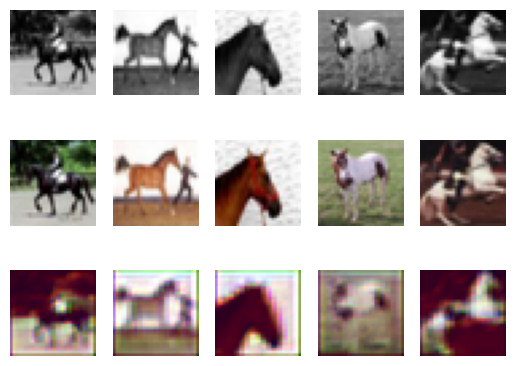

1 tensor(0.0139)


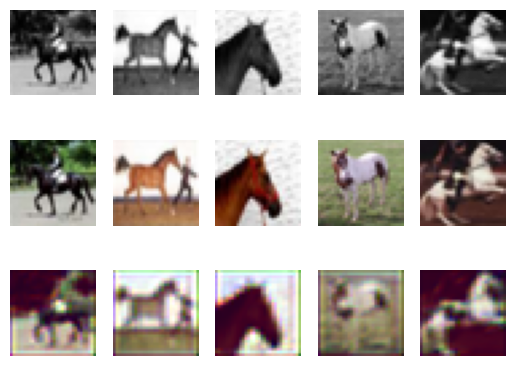

2 tensor(0.0117)


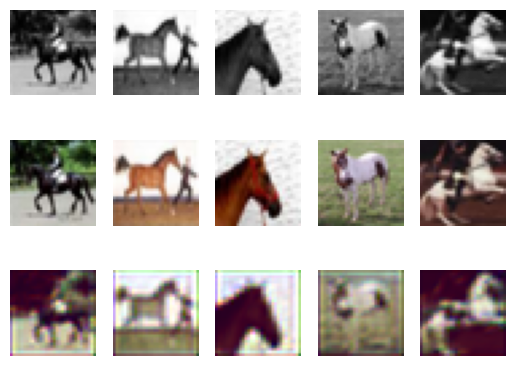

3 tensor(0.0105)


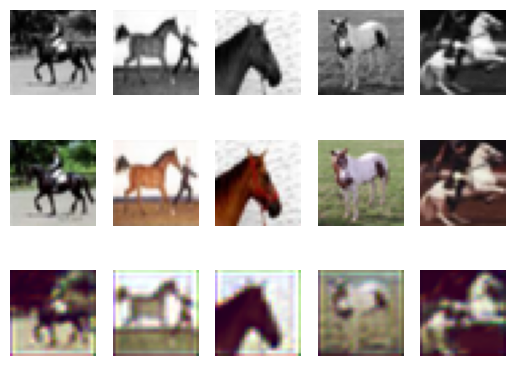

4 tensor(0.0098)


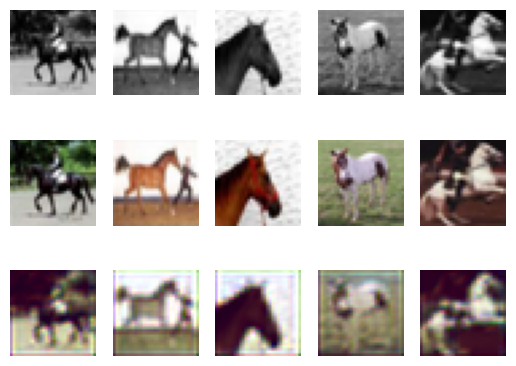

5 tensor(0.0091)


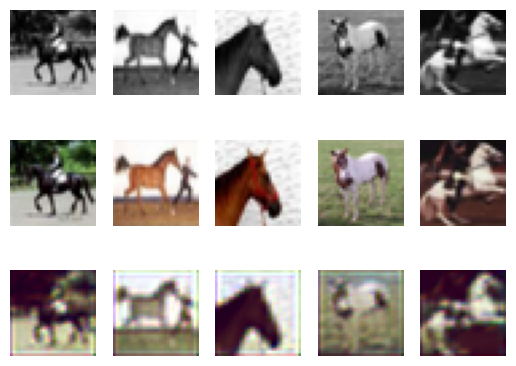

6 tensor(0.0085)


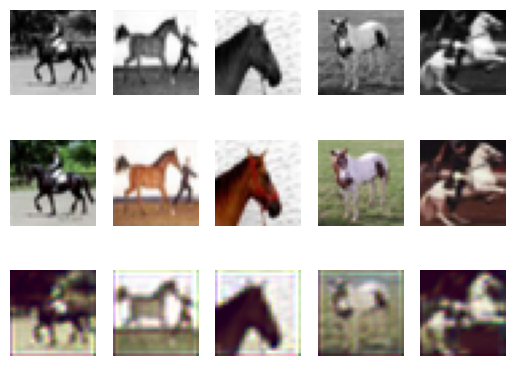

7 tensor(0.0081)


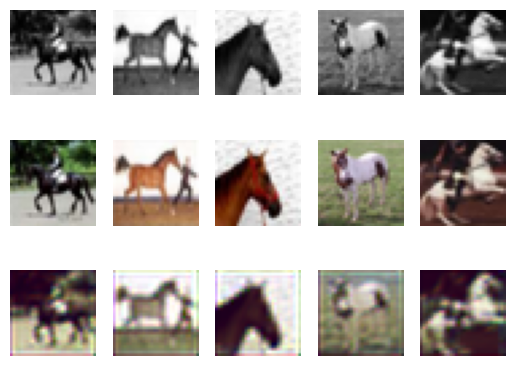

8 tensor(0.0077)


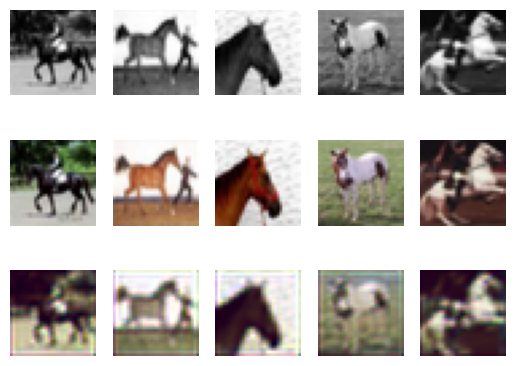

9 tensor(0.0073)


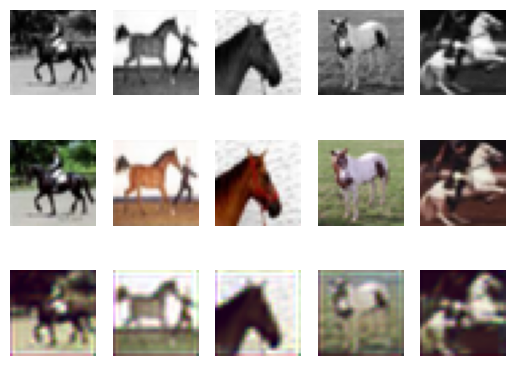

10 tensor(0.0070)


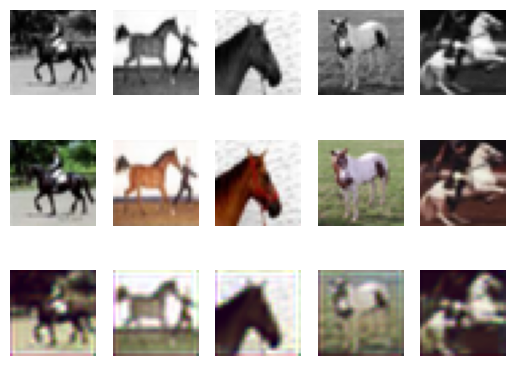

11 tensor(0.0067)


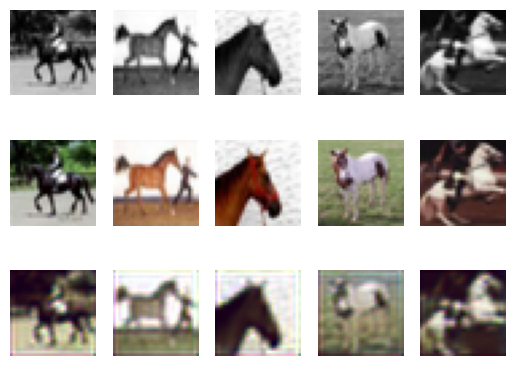

12 tensor(0.0065)


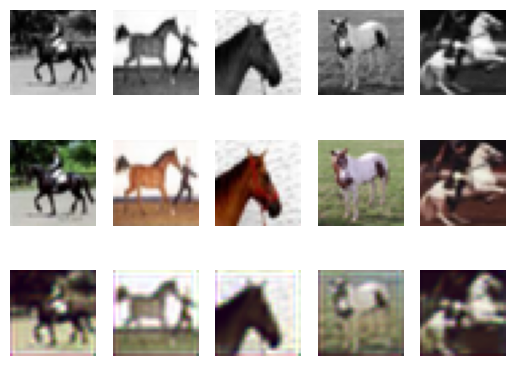

13 tensor(0.0062)


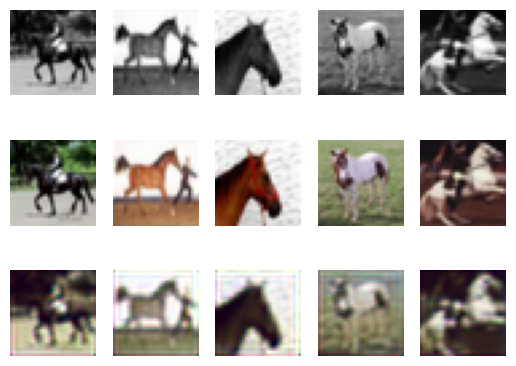

14 tensor(0.0061)


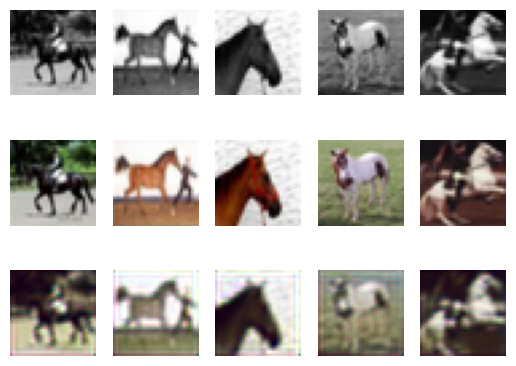

15 tensor(0.0059)


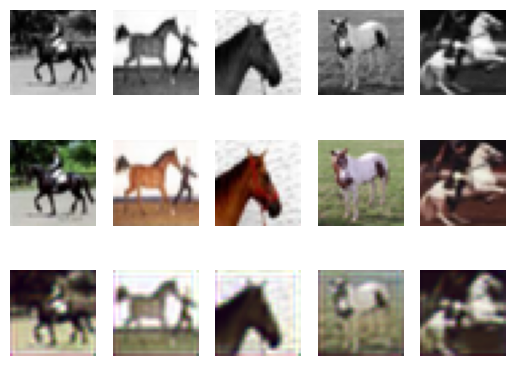

16 tensor(0.0057)


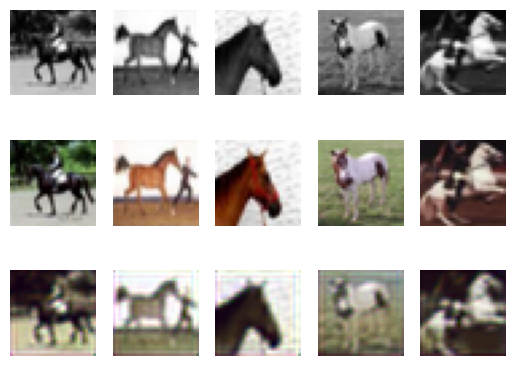

17 tensor(0.0056)


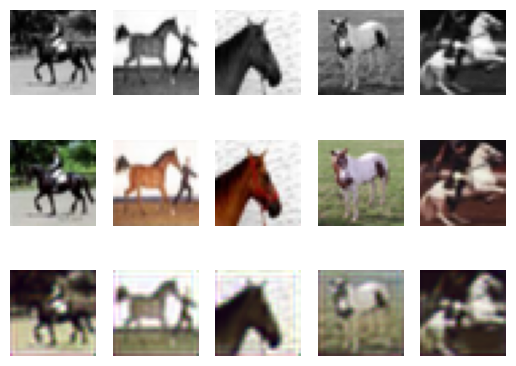

18 tensor(0.0054)


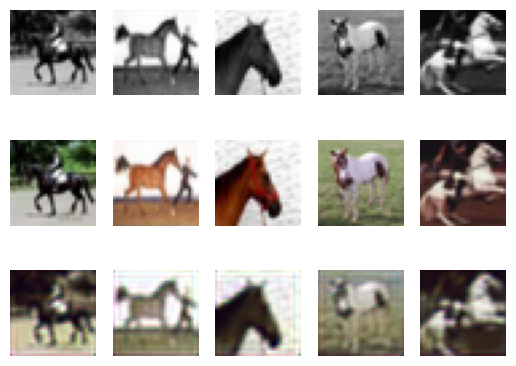

19 tensor(0.0053)


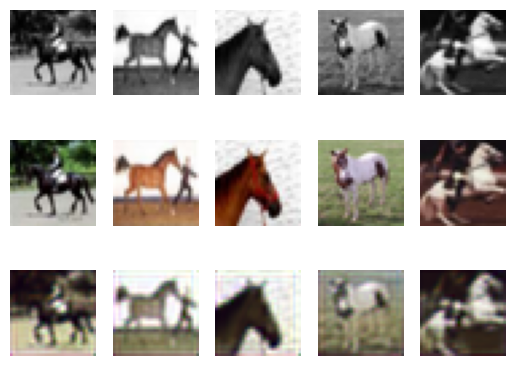

20 tensor(0.0052)


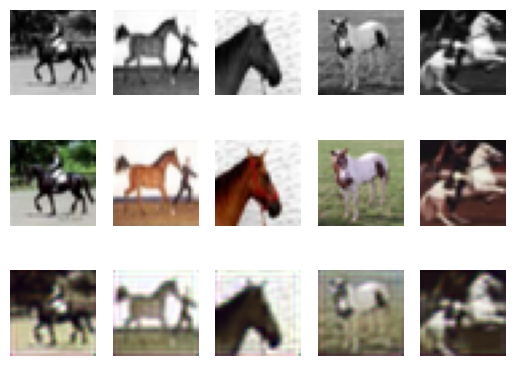

21 tensor(0.0051)


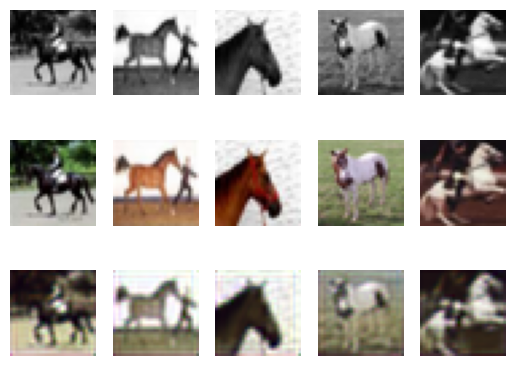

22 tensor(0.0050)


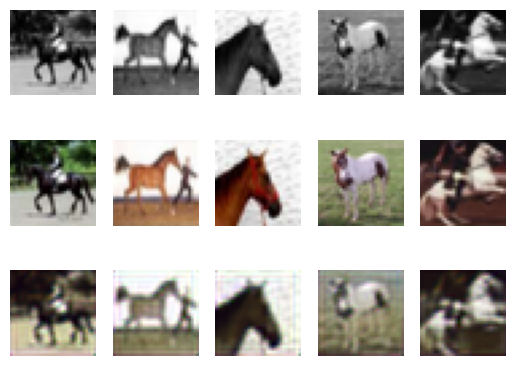

23 tensor(0.0049)


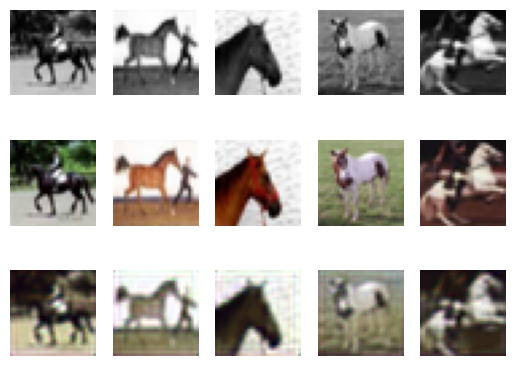

24 tensor(0.0048)


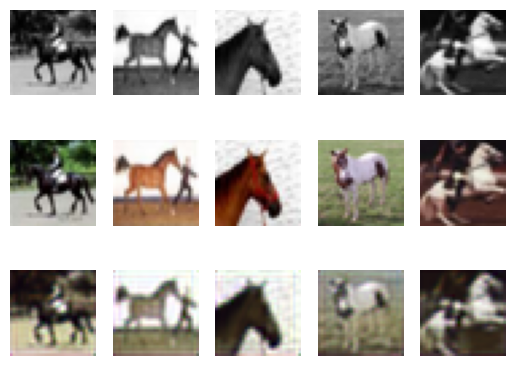

In [ ]:
# Main training loop for UNet
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "UNet",
    "kernel": 3,
    "num_filters": 32,
    'learn_rate':0.001,
    "batch_size": 100,
    "epochs": 25,
    "seed": 0,
    "plot": True,
    "experiment_name": "colourization_cnn",
    "visualize": False,
    "downsize_input": False,
}
args.update(args_dict)
cnn = train(args)

The result improved a lot comparing to the previous model. Skip connections improve the training loss and output qualitatively. With epoch=25, the previous
model has a final loss of 0.0088 whereas UNet model has a final loss of 0.0048, which is nearly a half of the previous one. For output quality, output
coloured images from UNet model is more similar to the orginal image and more colours that can be seen.
One possible reason is that some information is lost during downsampling and upsampling process. Skip connection helps us add back the information lost
like some details in an image and features from different resolution levels are merged, which enhances model's capbility to capture details. Therefore we
get a better result.
Another reason is that skip connections solve the vanishing gradient problem by passing weights from output towards input. This helps preserve gradients
and promote convergence.

### Part (iii)
Re-train a few more "UNet" models using different mini batch sizes with a fixed number of epochs.

Loading data...
File path: data/cifar-10-batches-py.tar.gz
Transforming data...
Beginning training ...
0 tensor(0.0088)


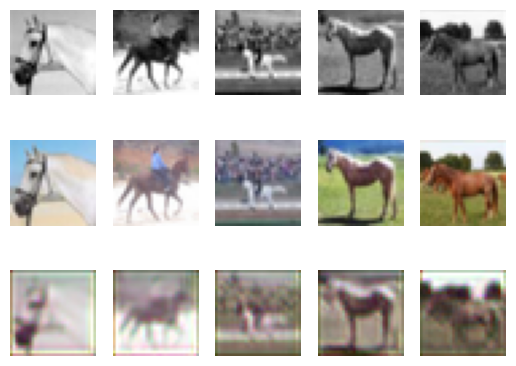

1 tensor(0.0070)


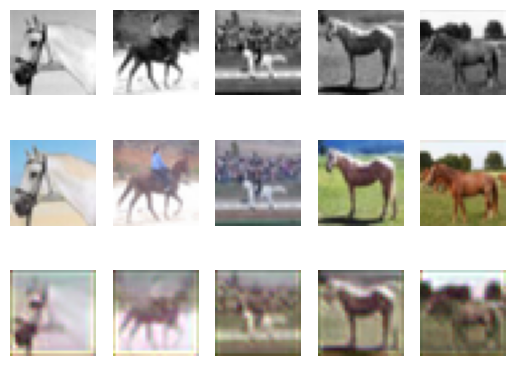

2 tensor(0.0059)


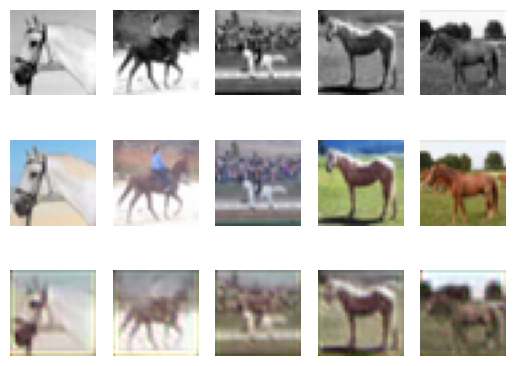

3 tensor(0.0054)


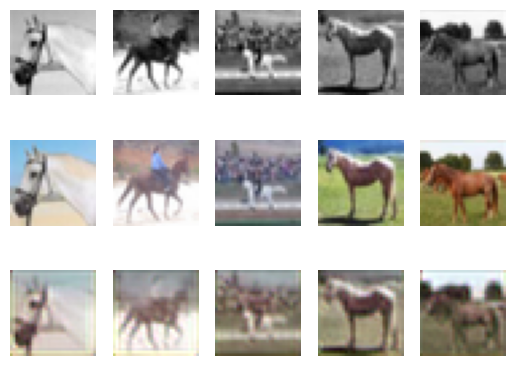

4 tensor(0.0050)


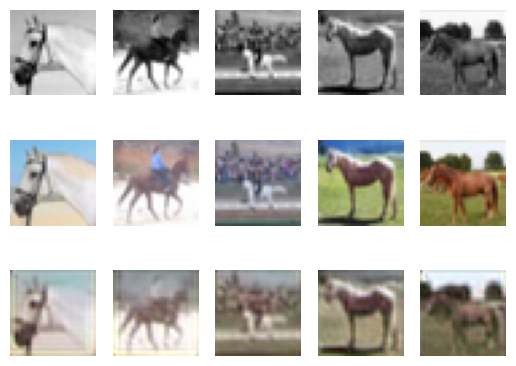

5 tensor(0.0048)


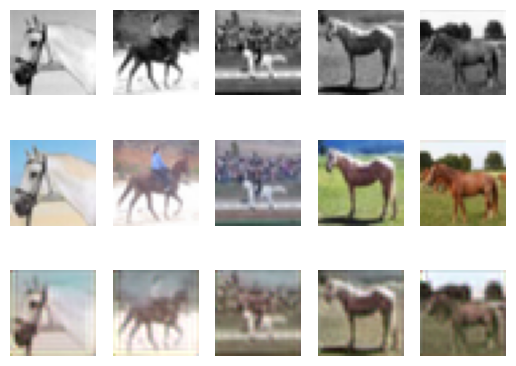

6 tensor(0.0045)


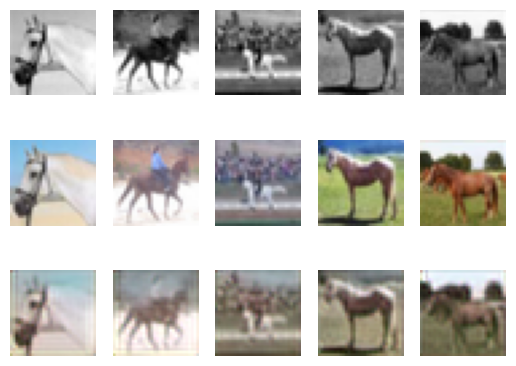

7 tensor(0.0043)


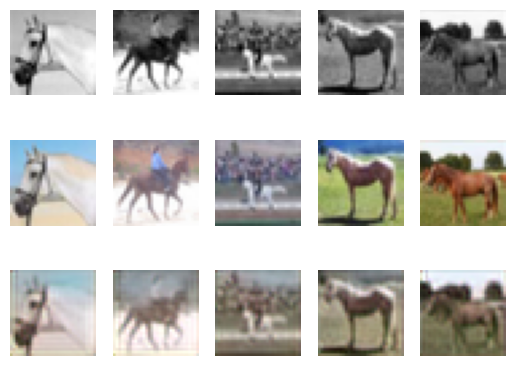

8 tensor(0.0042)


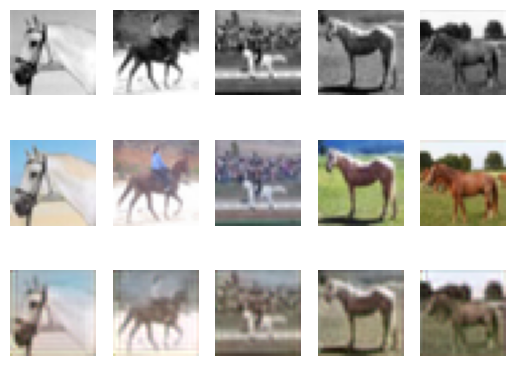

9 tensor(0.0041)


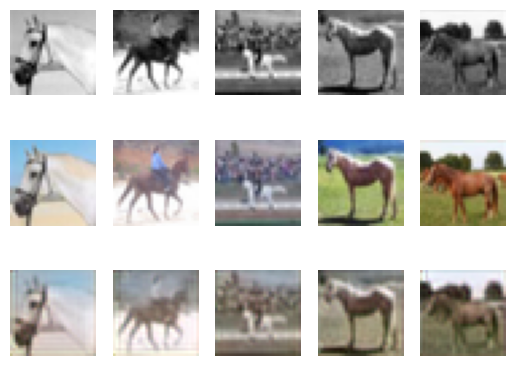

10 tensor(0.0039)


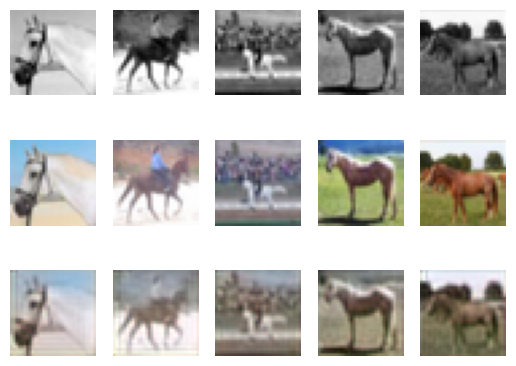

11 tensor(0.0038)


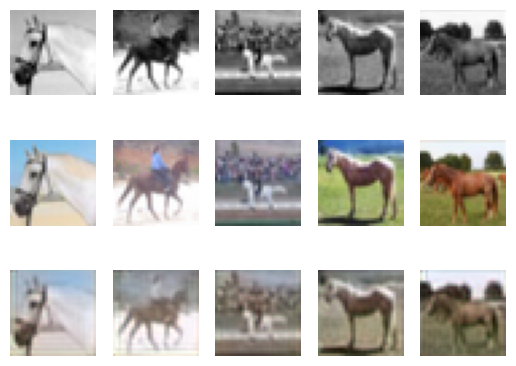

12 tensor(0.0037)


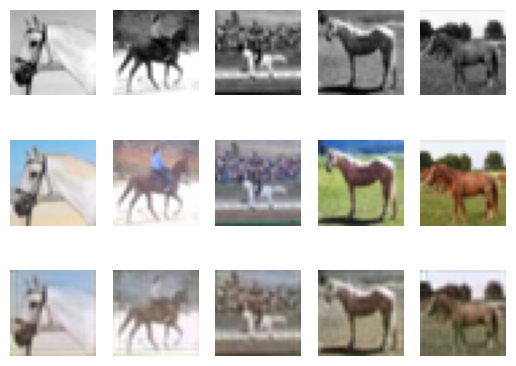

13 tensor(0.0035)


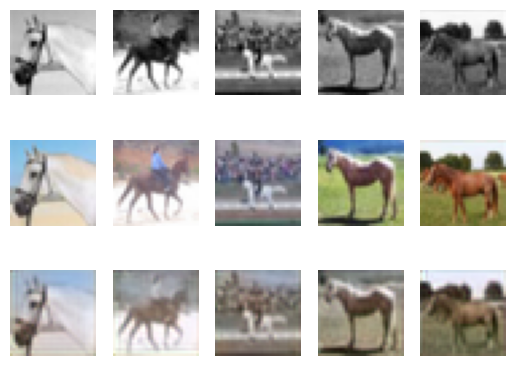

14 tensor(0.0034)


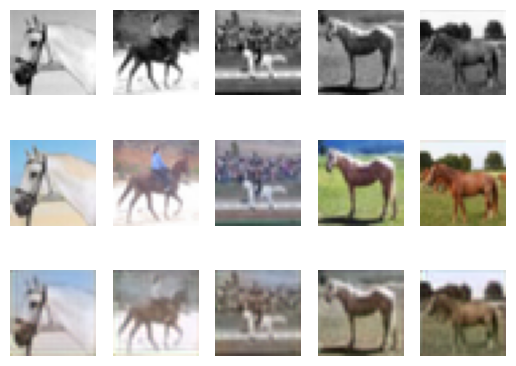

15 tensor(0.0033)


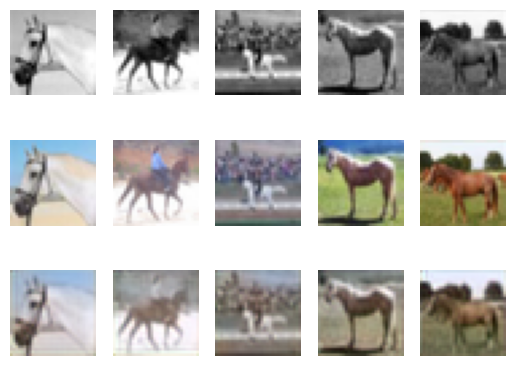

16 tensor(0.0032)


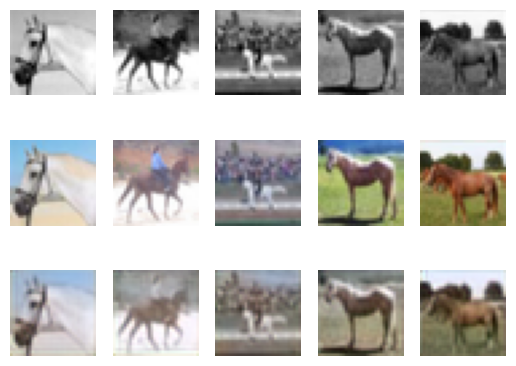

17 tensor(0.0031)


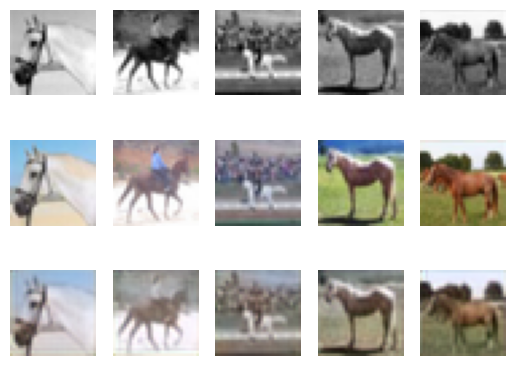

18 tensor(0.0030)


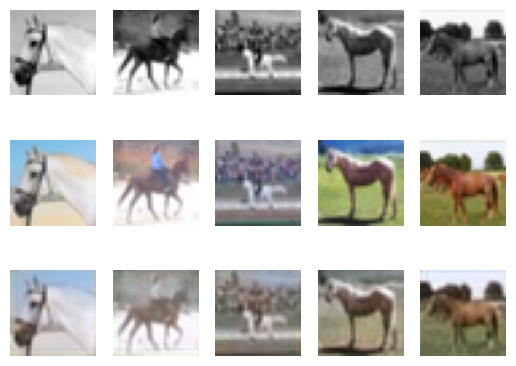

19 tensor(0.0029)


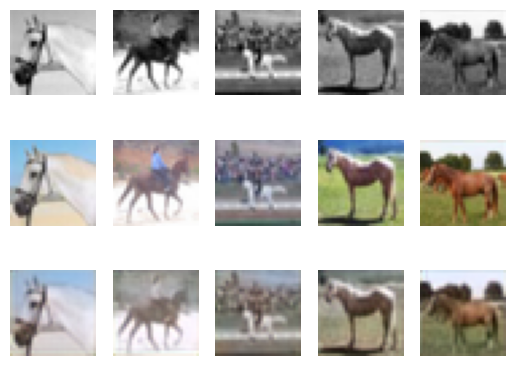

20 tensor(0.0029)


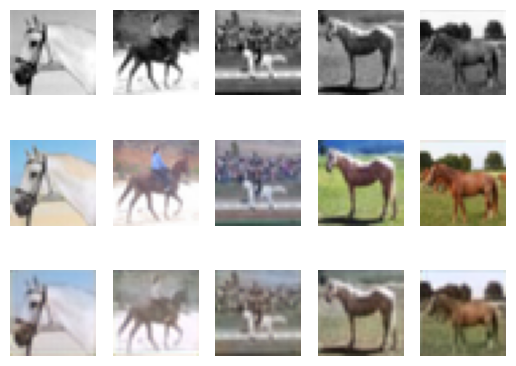

21 tensor(0.0028)


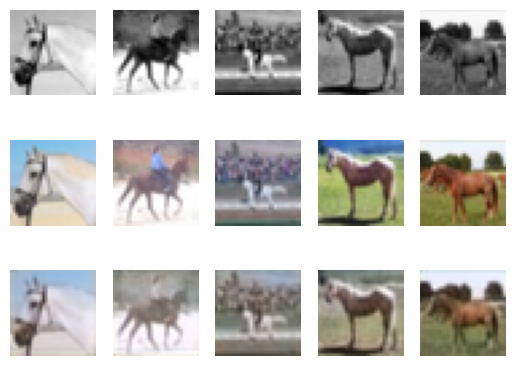

22 tensor(0.0028)


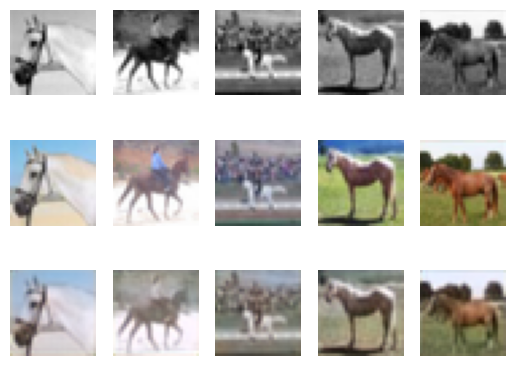

23 tensor(0.0027)


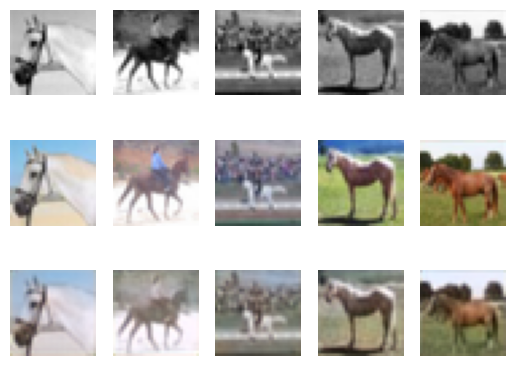

24 tensor(0.0026)


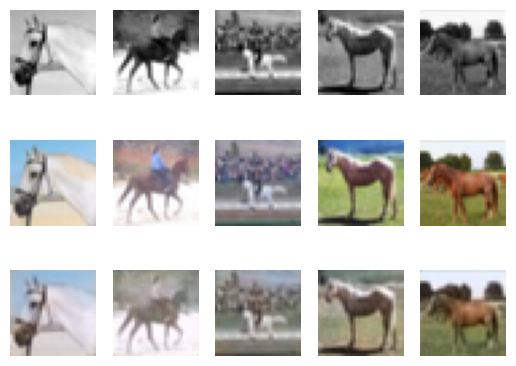

In [ ]:
#model 1: batch size = 20
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "UNet",
    "kernel": 3,
    "num_filters": 32,
    'learn_rate':0.001,
    "batch_size": 20,
    "epochs": 25,
    "seed": 0,
    "plot": True,
    "experiment_name": "colourization_cnn",
    "visualize": False,
    "downsize_input": False,
}
args.update(args_dict)
cnn = train(args)

Loading data...
File path: data/cifar-10-batches-py.tar.gz
Transforming data...
Beginning training ...
0 tensor(0.0151)


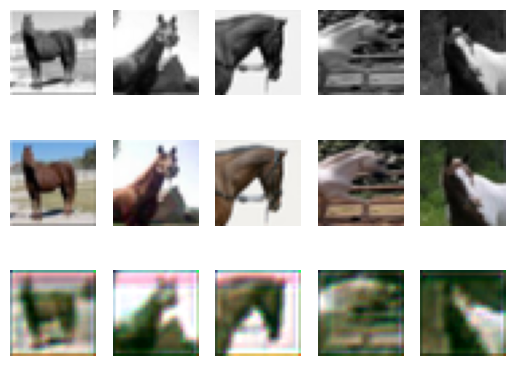

1 tensor(0.0115)


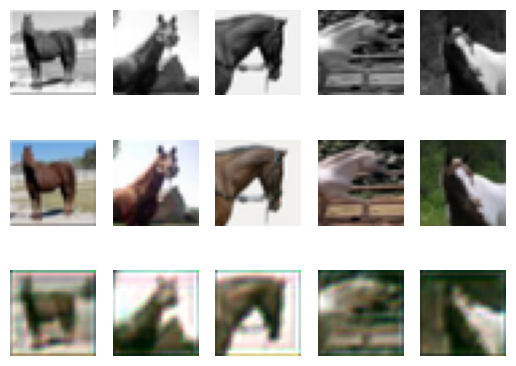

2 tensor(0.0100)


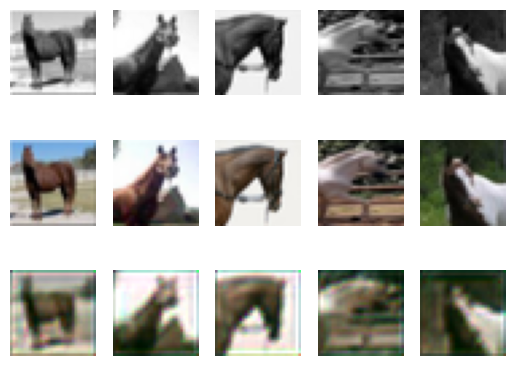

3 tensor(0.0088)


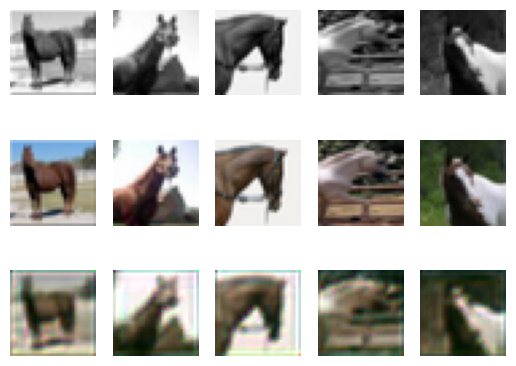

4 tensor(0.0079)


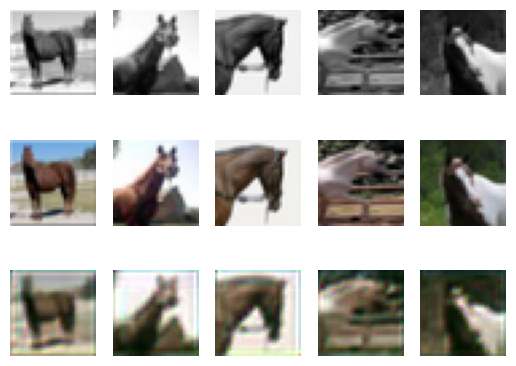

5 tensor(0.0073)


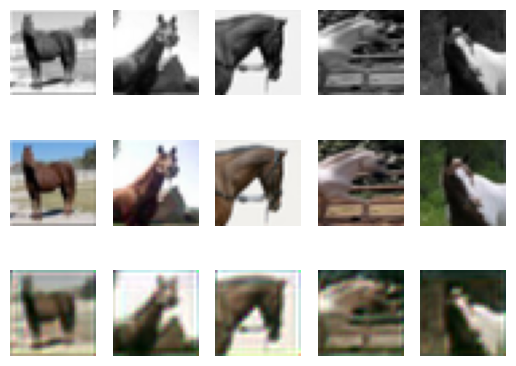

6 tensor(0.0069)


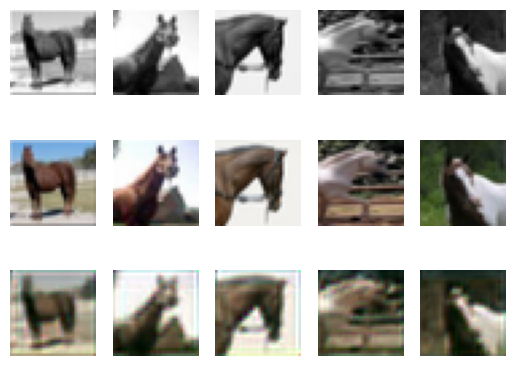

7 tensor(0.0065)


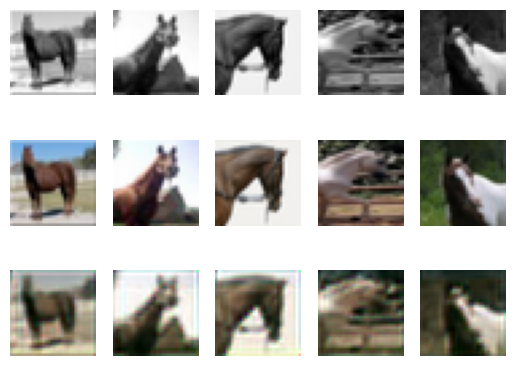

8 tensor(0.0062)


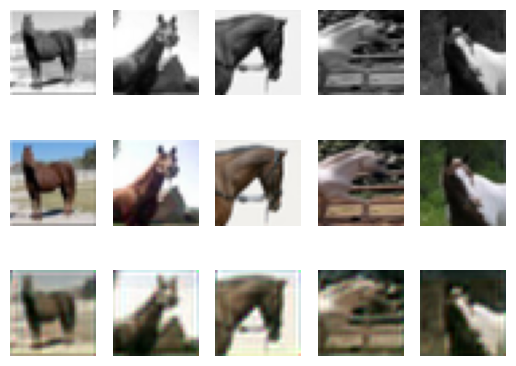

9 tensor(0.0060)


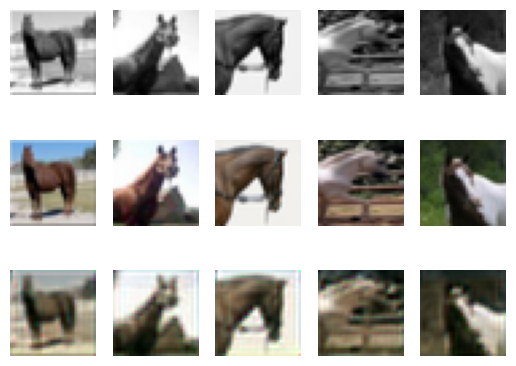

10 tensor(0.0058)


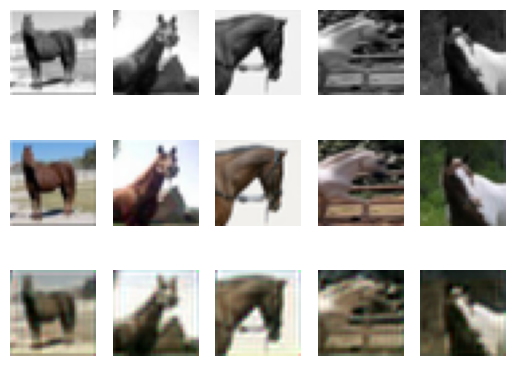

11 tensor(0.0056)


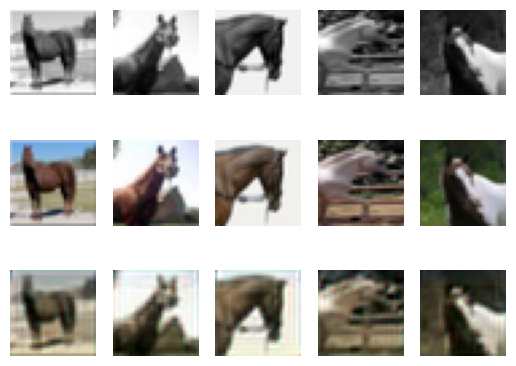

12 tensor(0.0054)


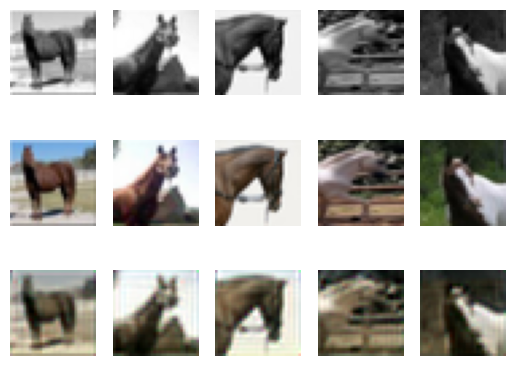

13 tensor(0.0052)


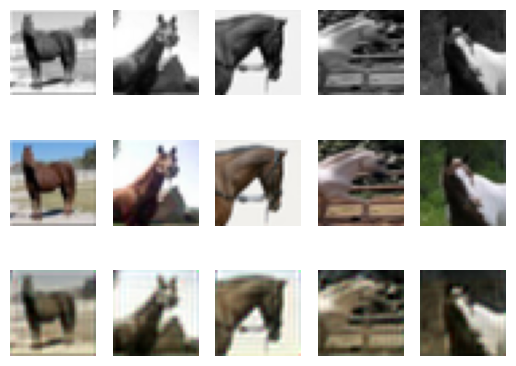

14 tensor(0.0051)


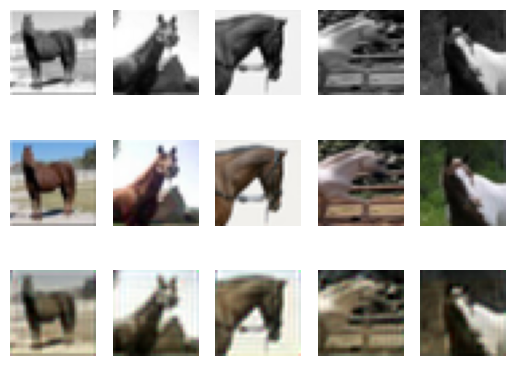

15 tensor(0.0050)


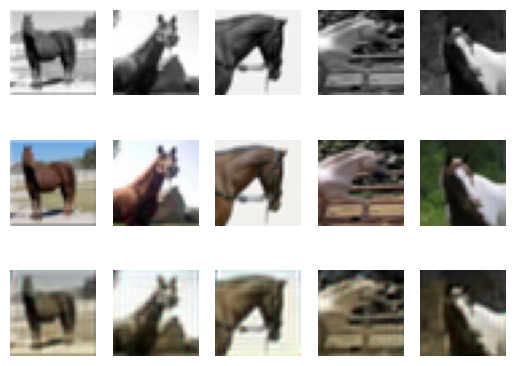

16 tensor(0.0049)


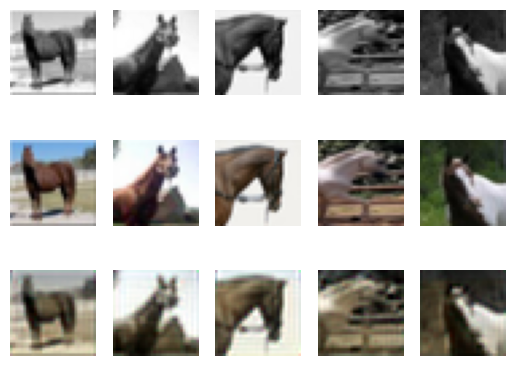

17 tensor(0.0047)


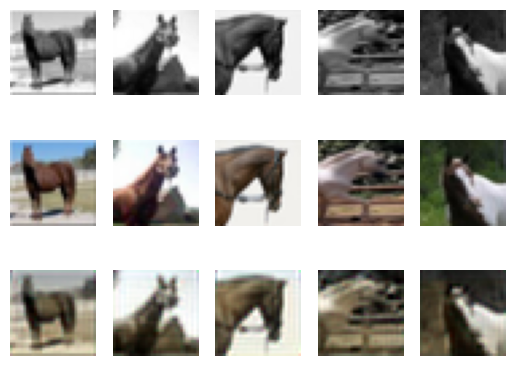

18 tensor(0.0046)


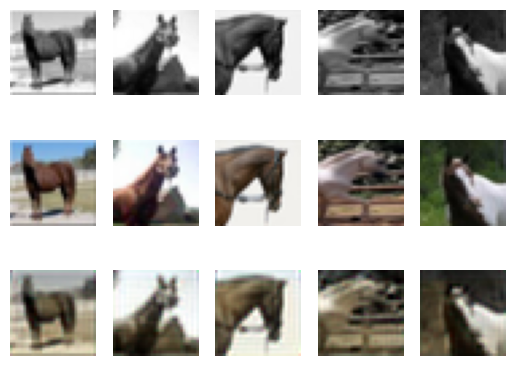

19 tensor(0.0045)


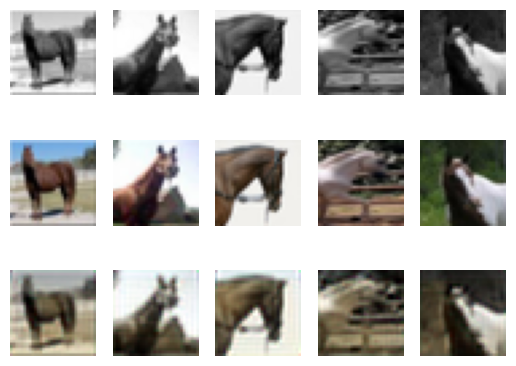

20 tensor(0.0044)


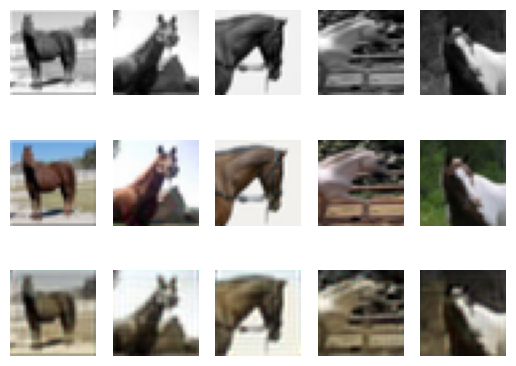

21 tensor(0.0044)


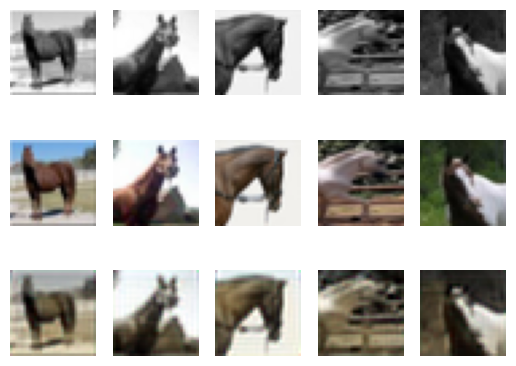

22 tensor(0.0043)


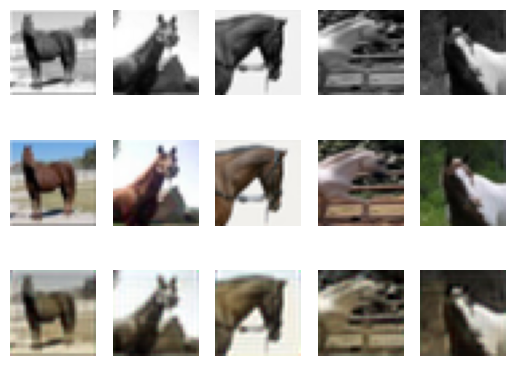

23 tensor(0.0042)


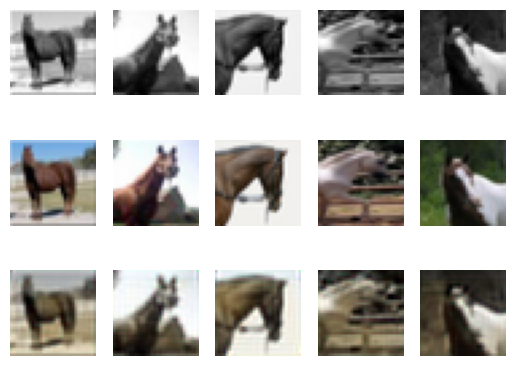

24 tensor(0.0041)


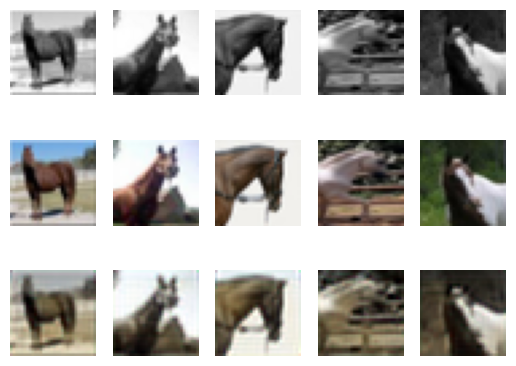

In [ ]:
#model 2: batch size = 50
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "UNet",
    "kernel": 3,
    "num_filters": 32,
    'learn_rate':0.001,
    "batch_size": 50,
    "epochs": 25,
    "seed": 0,
    "plot": True,
    "experiment_name": "colourization_cnn",
    "visualize": False,
    "downsize_input": False,
}
args.update(args_dict)
cnn = train(args)

Loading data...
File path: data/cifar-10-batches-py.tar.gz
Transforming data...
Beginning training ...
0 tensor(0.0223)


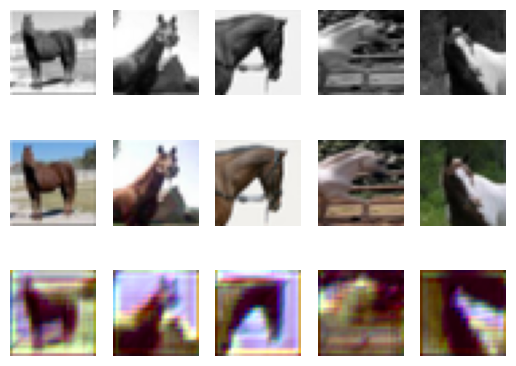

1 tensor(0.0142)


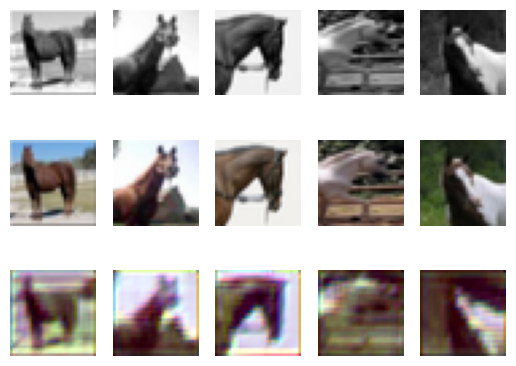

2 tensor(0.0123)


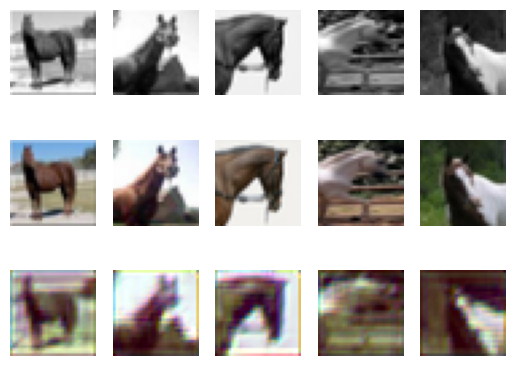

3 tensor(0.0114)


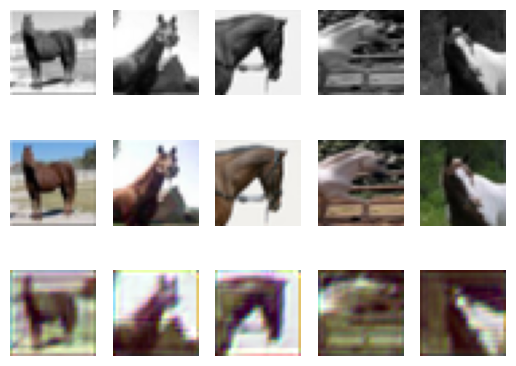

4 tensor(0.0106)


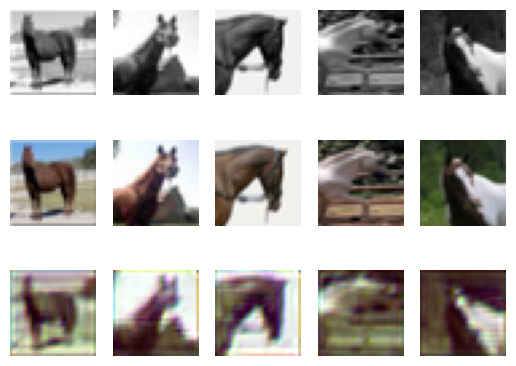

5 tensor(0.0100)


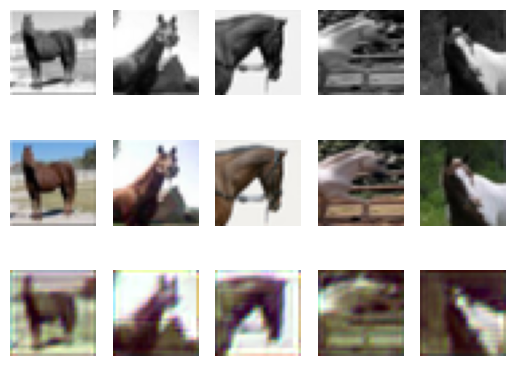

6 tensor(0.0095)


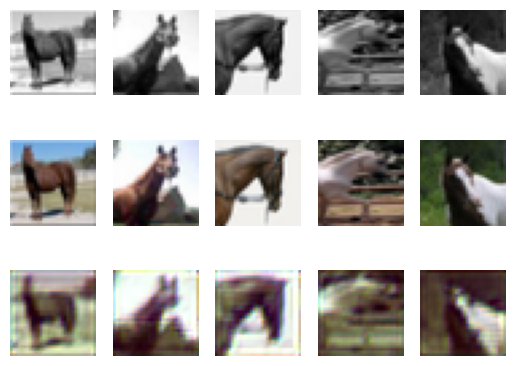

7 tensor(0.0091)


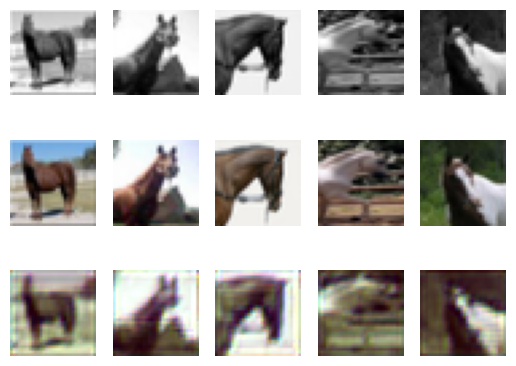

8 tensor(0.0086)


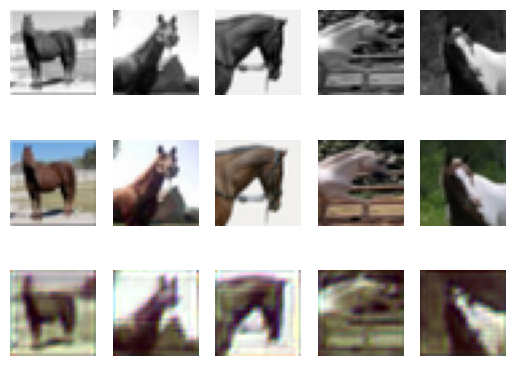

9 tensor(0.0083)


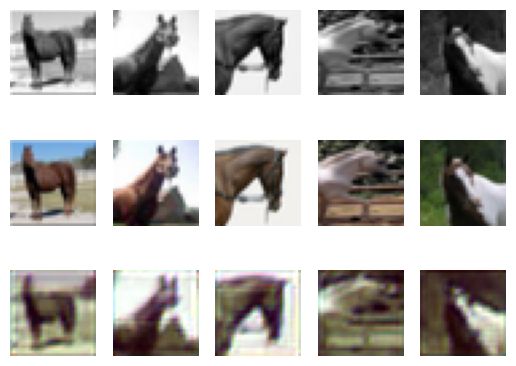

10 tensor(0.0079)


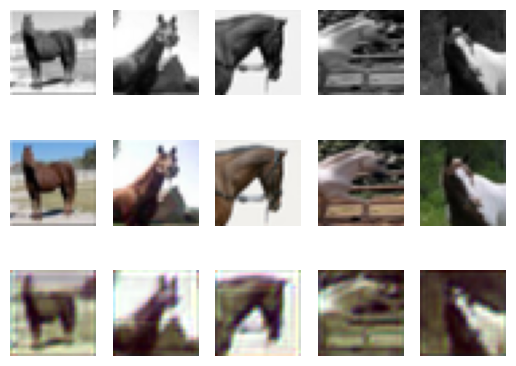

11 tensor(0.0076)


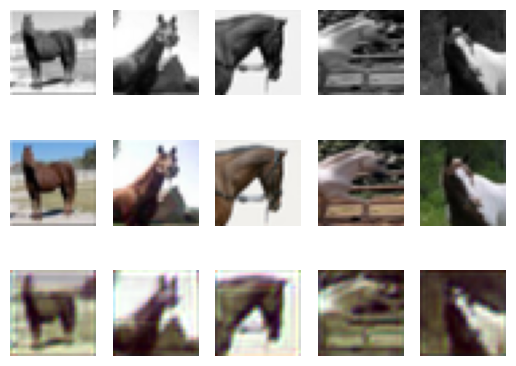

12 tensor(0.0074)


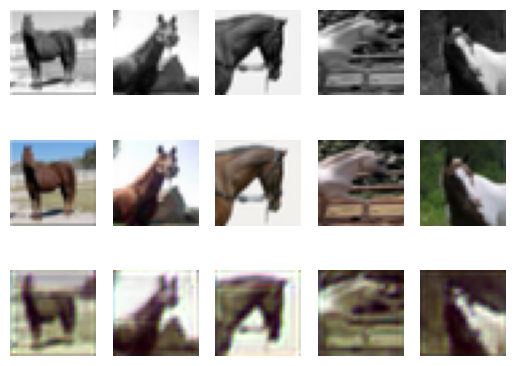

13 tensor(0.0071)


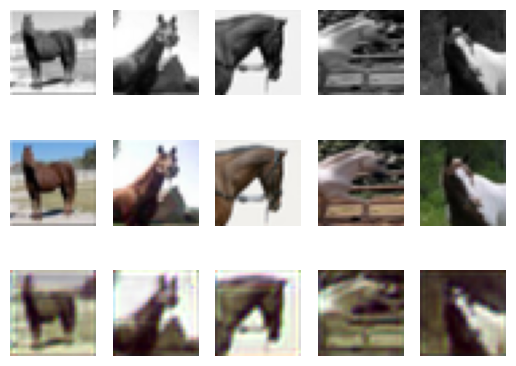

14 tensor(0.0069)


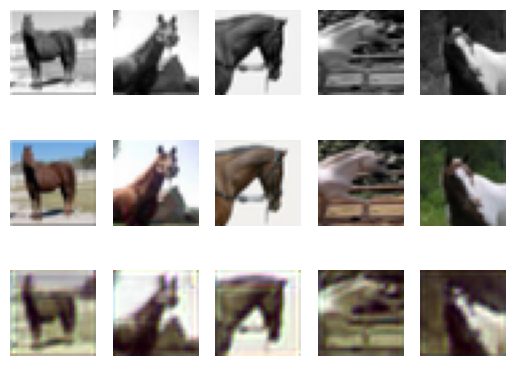

15 tensor(0.0068)


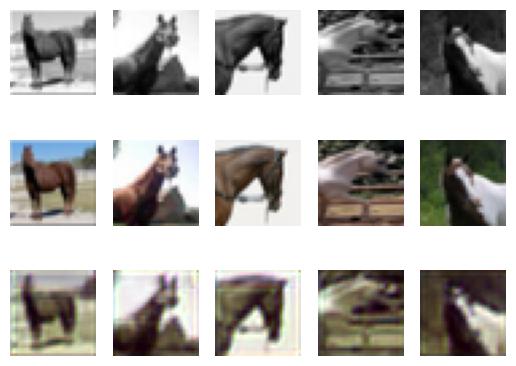

16 tensor(0.0066)


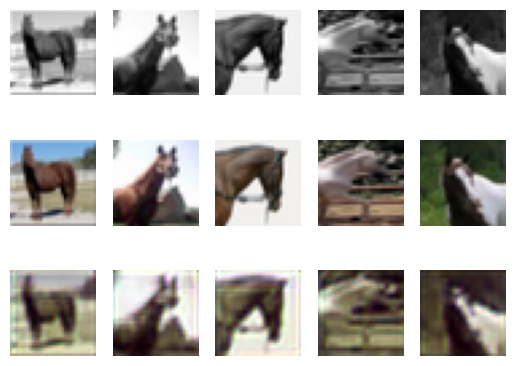

17 tensor(0.0064)


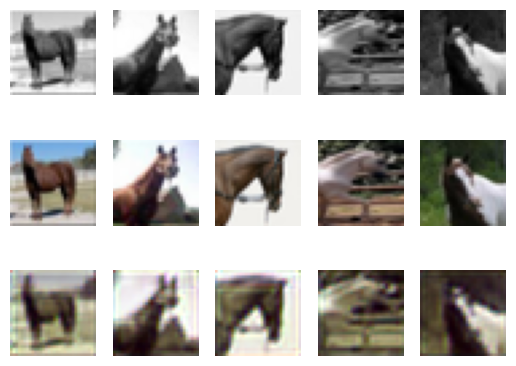

18 tensor(0.0063)


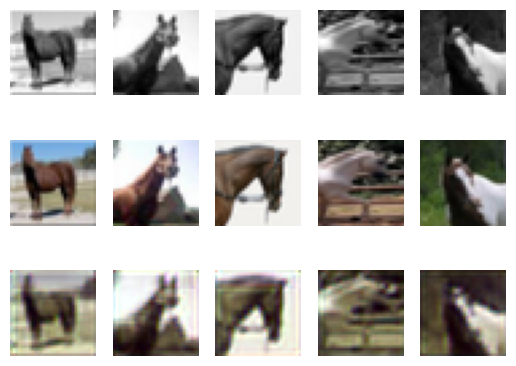

19 tensor(0.0061)


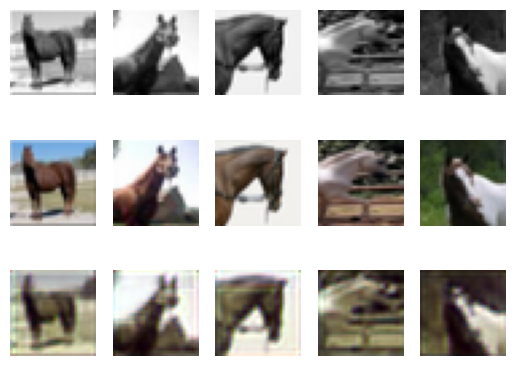

20 tensor(0.0060)


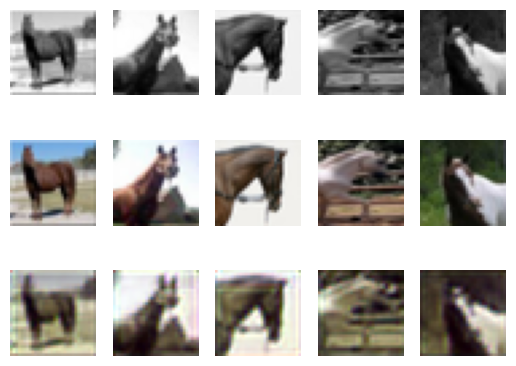

21 tensor(0.0059)


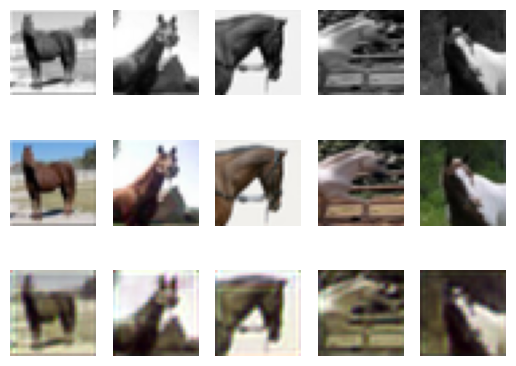

22 tensor(0.0058)


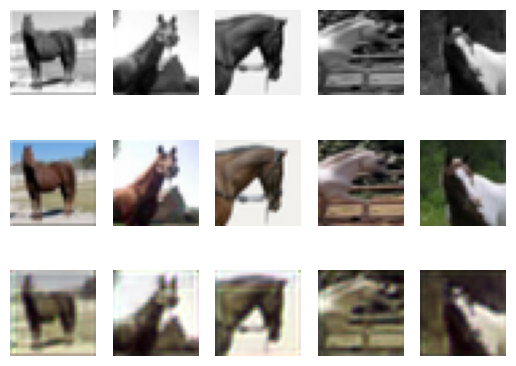

23 tensor(0.0057)


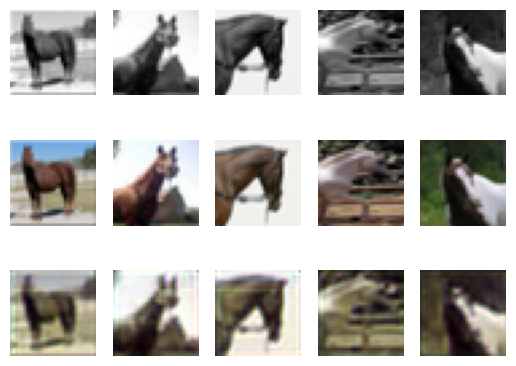

24 tensor(0.0055)


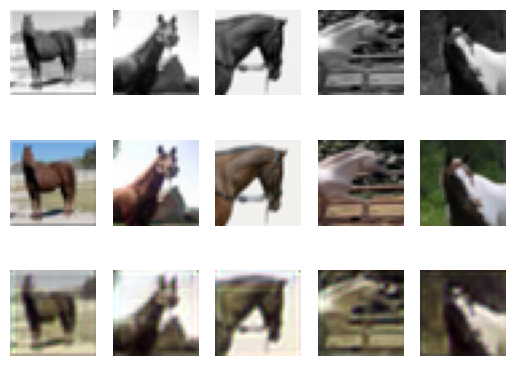

In [ ]:
#model 3: batch size = 150
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "UNet",
    "kernel": 3,
    "num_filters": 32,
    'learn_rate':0.001,
    "batch_size": 150,
    "epochs": 25,
    "seed": 0,
    "plot": True,
    "experiment_name": "colourization_cnn",
    "visualize": False,
    "downsize_input": False,
}
args.update(args_dict)
cnn = train(args)

Loading data...
File path: data/cifar-10-batches-py.tar.gz
Transforming data...
Beginning training ...
0 tensor(0.0231)


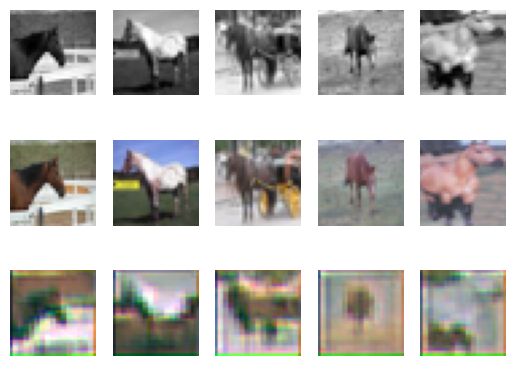

1 tensor(0.0183)


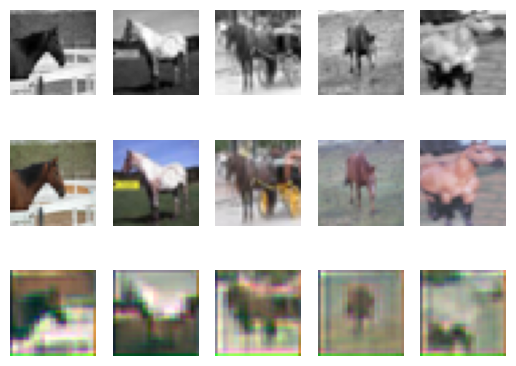

2 tensor(0.0155)


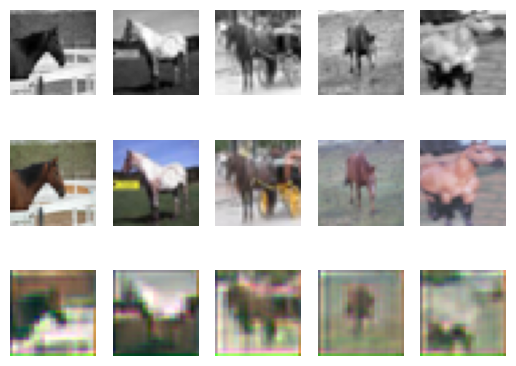

3 tensor(0.0136)


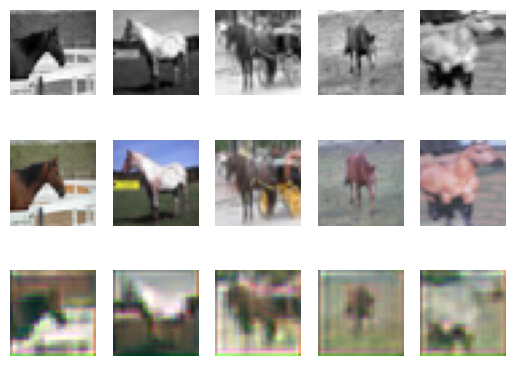

4 tensor(0.0122)


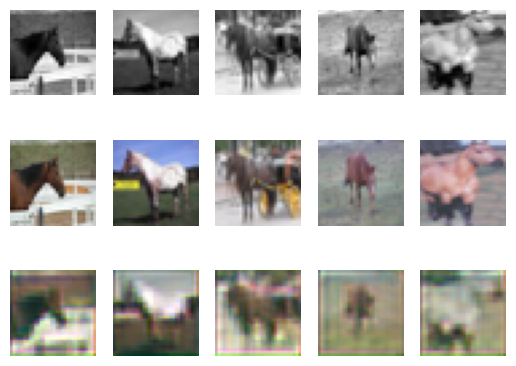

5 tensor(0.0111)


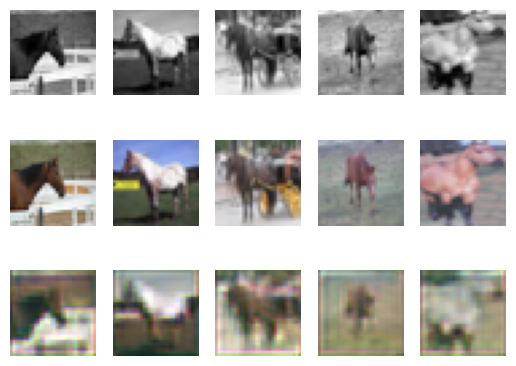

6 tensor(0.0102)


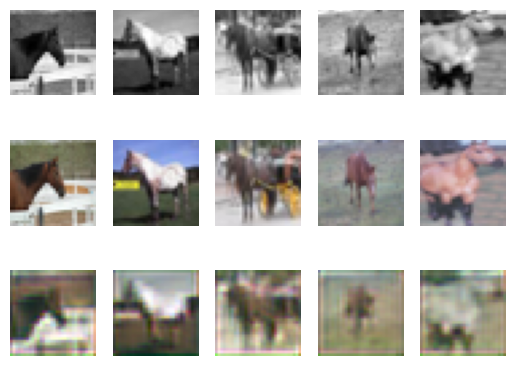

7 tensor(0.0095)


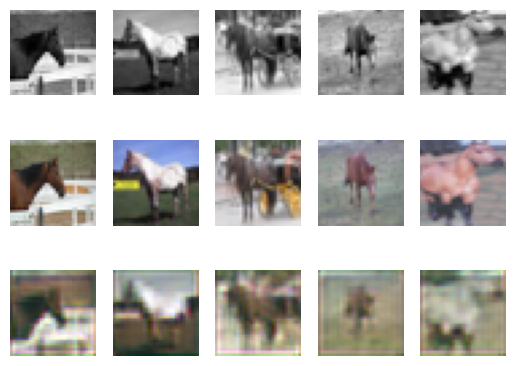

8 tensor(0.0090)


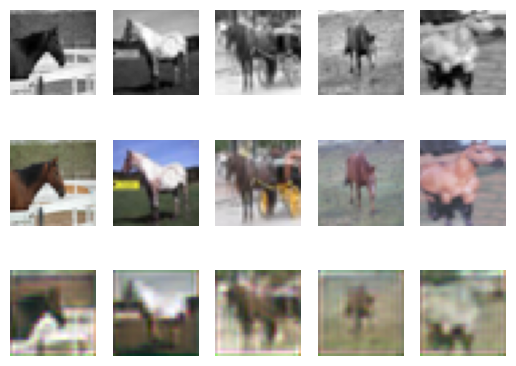

9 tensor(0.0085)


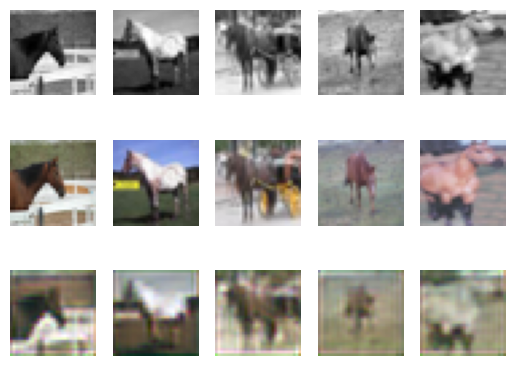

10 tensor(0.0081)


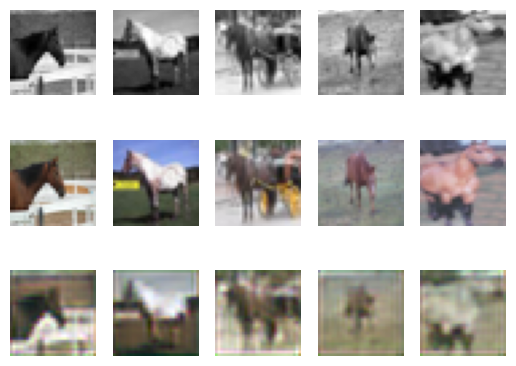

11 tensor(0.0078)


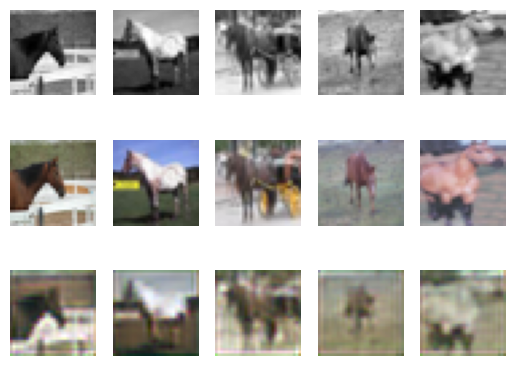

12 tensor(0.0075)


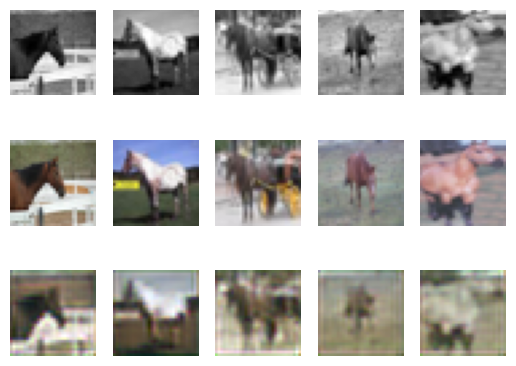

13 tensor(0.0072)


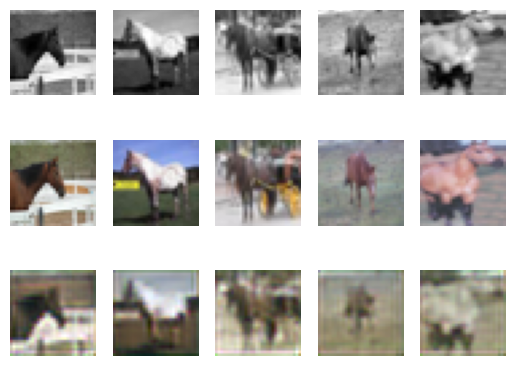

14 tensor(0.0070)


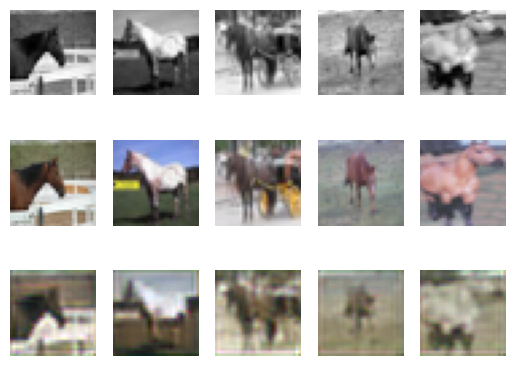

15 tensor(0.0068)


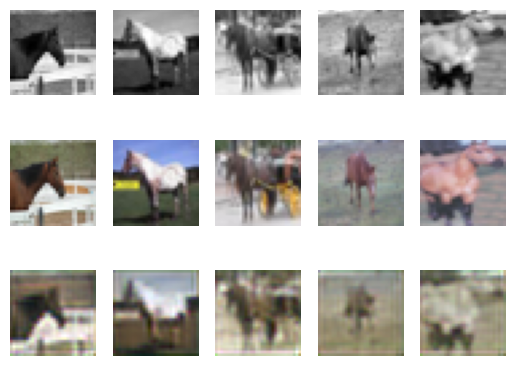

16 tensor(0.0066)


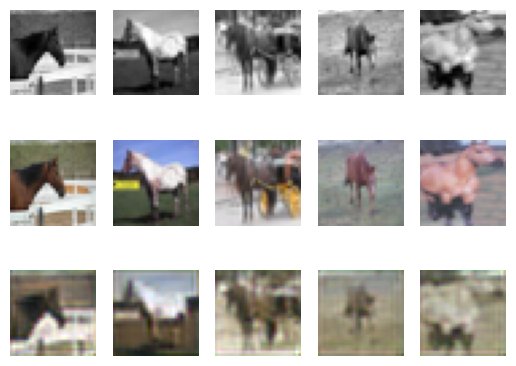

17 tensor(0.0064)


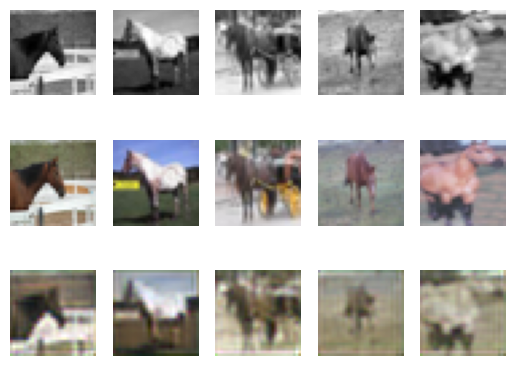

18 tensor(0.0063)


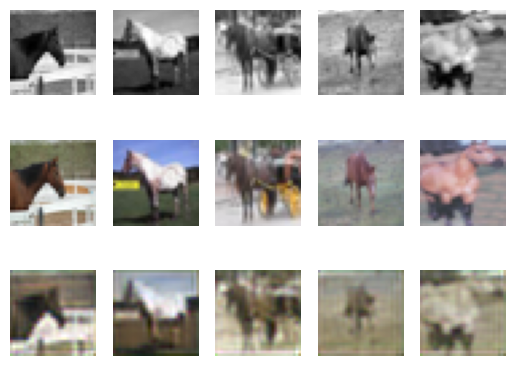

19 tensor(0.0061)


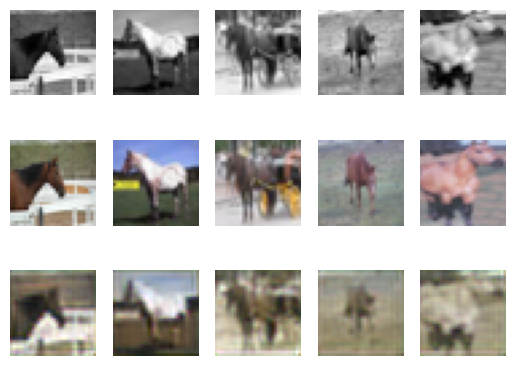

20 tensor(0.0060)


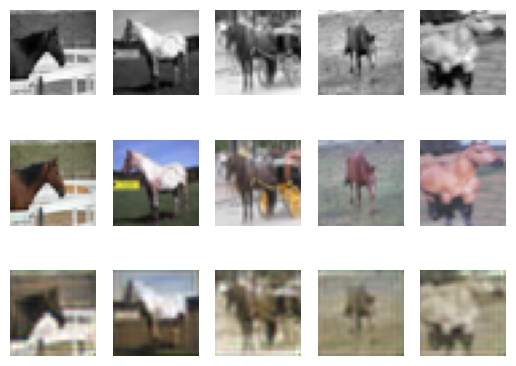

21 tensor(0.0059)


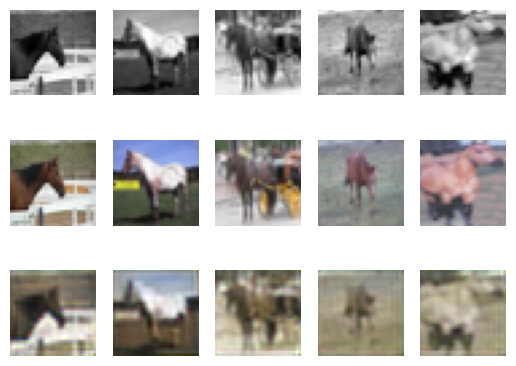

22 tensor(0.0057)


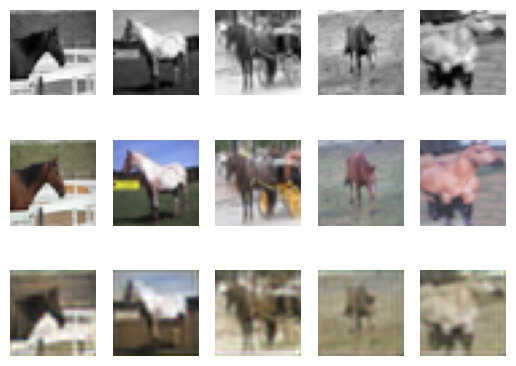

23 tensor(0.0056)


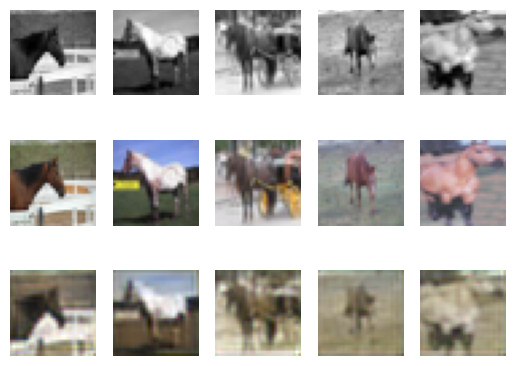

24 tensor(0.0055)


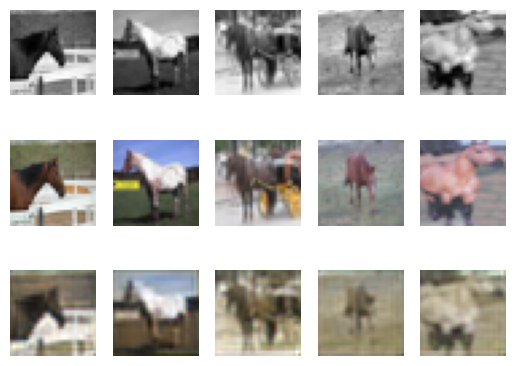

In [ ]:
#model 4: batch size = 200
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "UNet",
    "kernel": 3,
    "num_filters": 32,
    'learn_rate':0.001,
    "batch_size": 200,
    "epochs": 25,
    "seed": 0,
    "plot": True,
    "experiment_name": "colourization_cnn",
    "visualize": False,
    "downsize_input": False,
}
args.update(args_dict)
cnn = train(args)

Describe the effect of batch sizes on the training/validation loss, and the final image output.

I trained 4 models with batch size = 20, 50, 150, 200. It can be seen that as batch size decreases, the training loss improves and it is smaller. For
example, the final training loss for batch size = 20 is 0.0026 whereas the training loss for batch size = 200 is 0.0055. As batch size decreases, the
image output also improves, more colors can be seen in the output colored images and the output colored images is more similar to the original images.